In [8]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        pass
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [64]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np

In [65]:
!pip install torch torchvision -q 

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


In [66]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64

In [68]:
celebA_dir = '/kaggle/input/celeba-dataset/img_align_celeba/'

In [69]:
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = datasets.ImageFolder(celebA_dir, transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

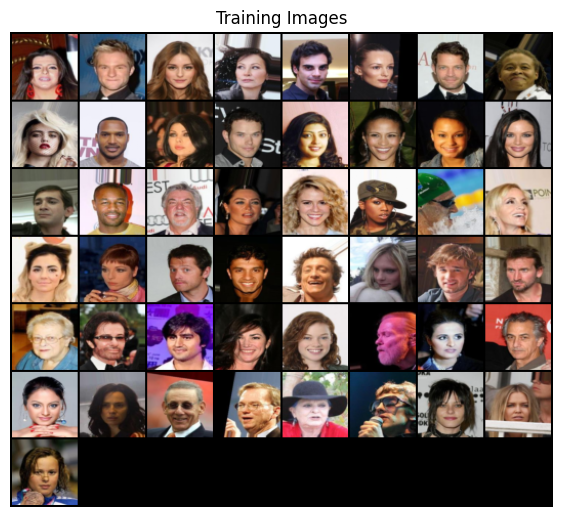

In [70]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:49], padding=2, normalize=True).cpu(),(1,2,0)))

In [71]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.net(x)
    
##################################################

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.disc(x)
    
##################################
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)
        
###########################

gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)

initialize_weights(gen)
initialize_weights(disc)


##############################
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

In [73]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

Epoch [0/5] Batch 0/1583                   Loss D: 0.7033, loss G: 2.0490


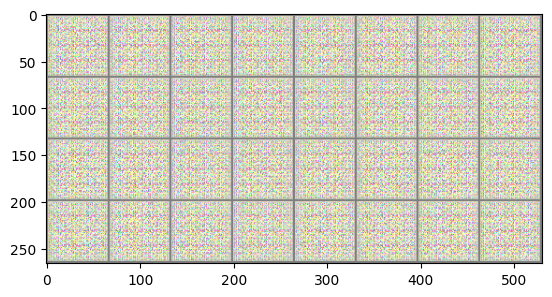

Epoch [0/5] Batch 50/1583                   Loss D: 0.1033, loss G: 10.8703


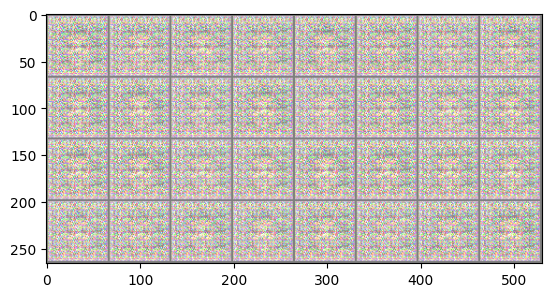

Epoch [0/5] Batch 100/1583                   Loss D: 0.7587, loss G: 1.1486


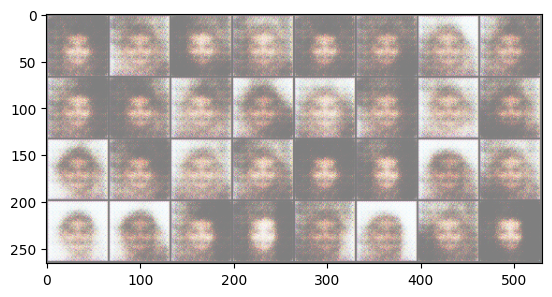

Epoch [0/5] Batch 150/1583                   Loss D: 0.2668, loss G: 3.3750


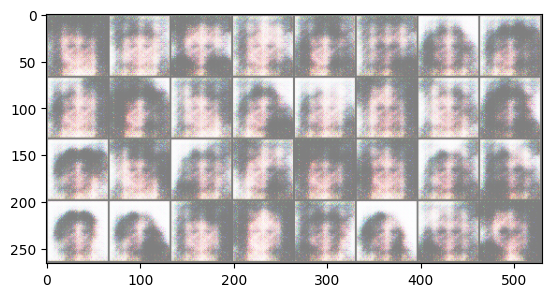

Epoch [0/5] Batch 200/1583                   Loss D: 0.3640, loss G: 4.1912


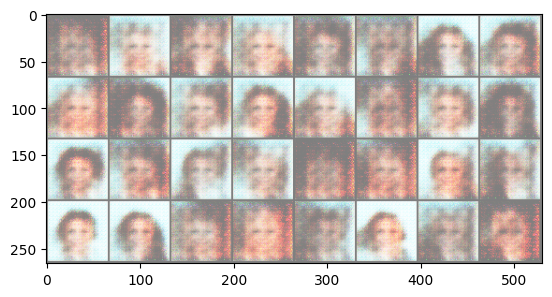

Epoch [0/5] Batch 250/1583                   Loss D: 0.4620, loss G: 2.7808


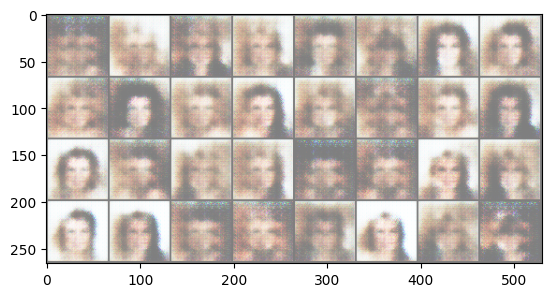

Epoch [0/5] Batch 300/1583                   Loss D: 0.7173, loss G: 3.1083


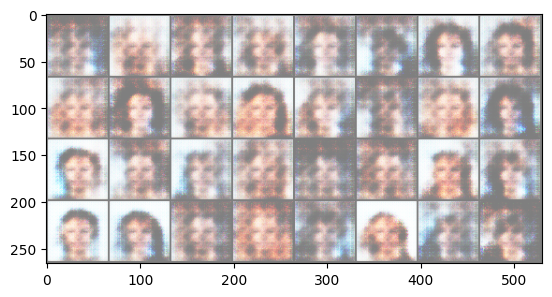

Epoch [0/5] Batch 350/1583                   Loss D: 0.6512, loss G: 1.8940


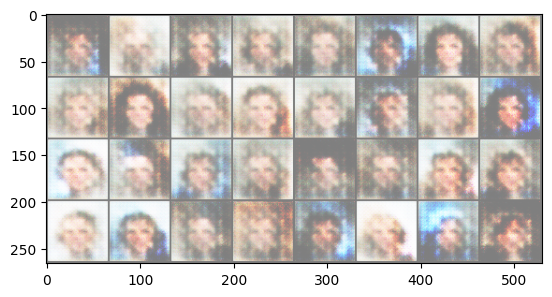

Epoch [0/5] Batch 400/1583                   Loss D: 0.4452, loss G: 2.2768


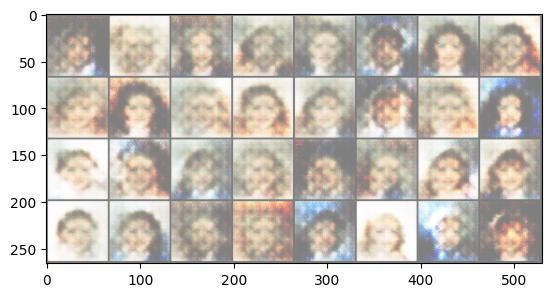

Epoch [0/5] Batch 450/1583                   Loss D: 0.5127, loss G: 1.7467


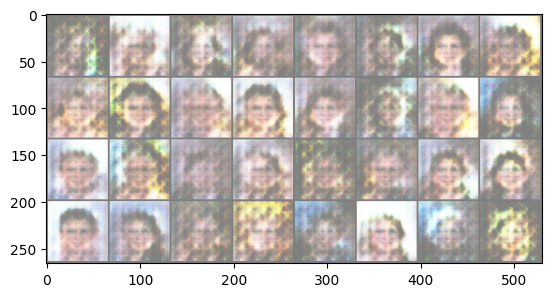

Epoch [0/5] Batch 500/1583                   Loss D: 0.3708, loss G: 2.1168


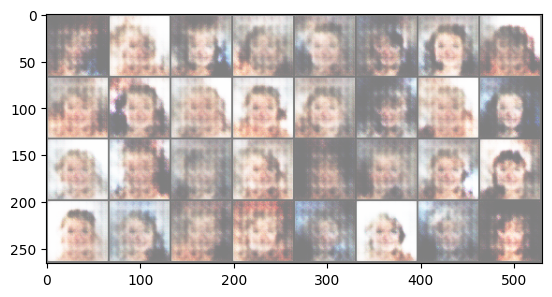

Epoch [0/5] Batch 550/1583                   Loss D: 0.6748, loss G: 5.2915


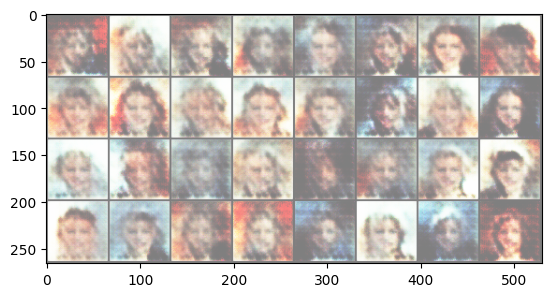

Epoch [0/5] Batch 600/1583                   Loss D: 0.5353, loss G: 2.7996


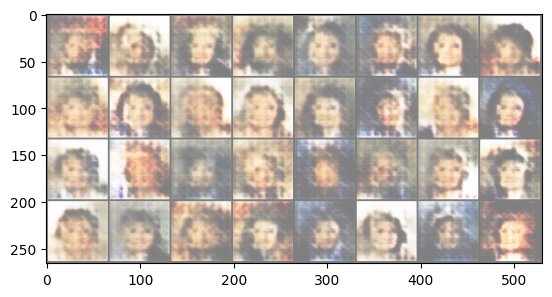

Epoch [0/5] Batch 650/1583                   Loss D: 0.5214, loss G: 3.8934


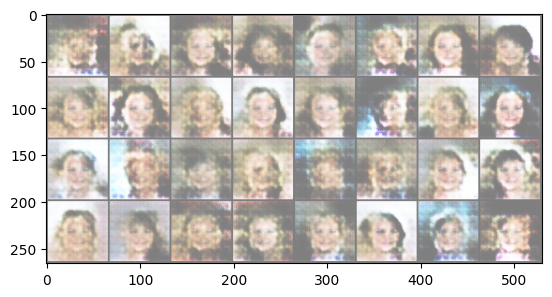

Epoch [0/5] Batch 700/1583                   Loss D: 0.4689, loss G: 2.3110


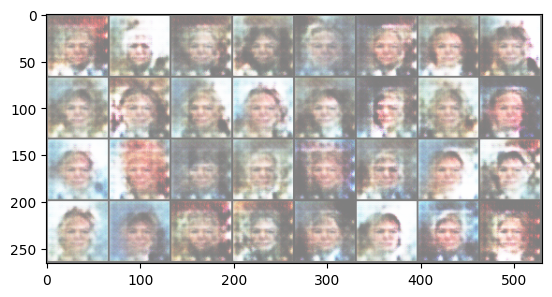

Epoch [0/5] Batch 750/1583                   Loss D: 0.5709, loss G: 2.9872


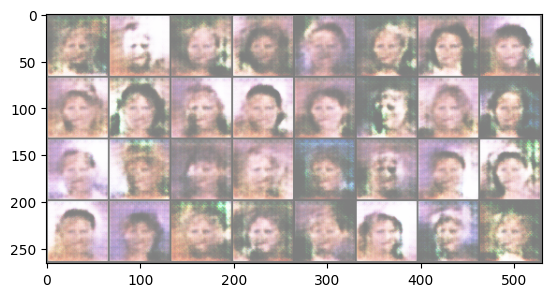

Epoch [0/5] Batch 800/1583                   Loss D: 0.5727, loss G: 3.5233


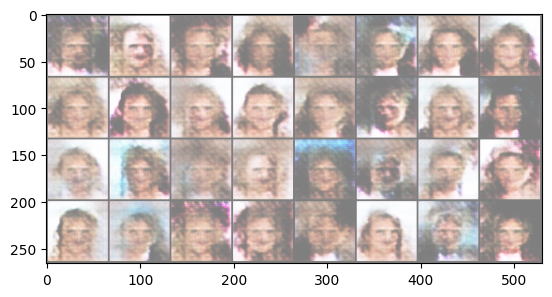

Epoch [0/5] Batch 850/1583                   Loss D: 0.3938, loss G: 1.9692


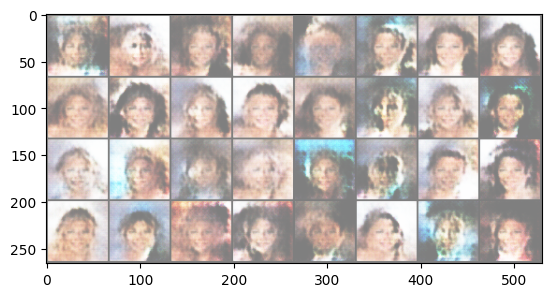

Epoch [0/5] Batch 900/1583                   Loss D: 0.5942, loss G: 4.4943


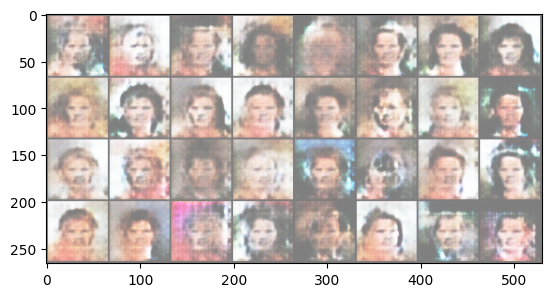

Epoch [0/5] Batch 950/1583                   Loss D: 0.4600, loss G: 2.0373


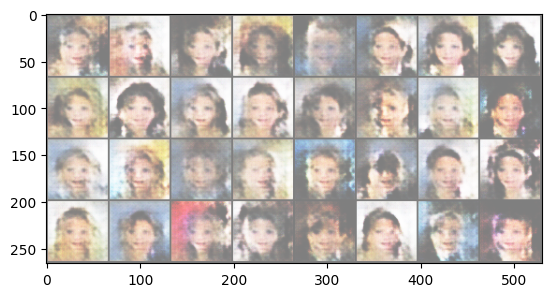

Epoch [0/5] Batch 1000/1583                   Loss D: 0.4479, loss G: 2.0319


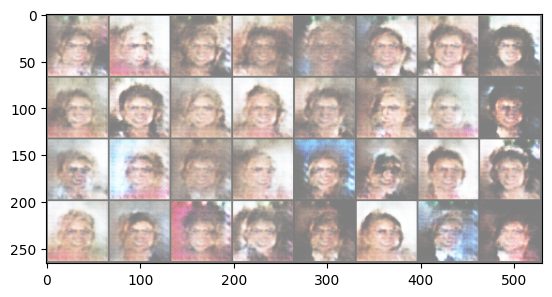

Epoch [0/5] Batch 1050/1583                   Loss D: 0.3694, loss G: 3.1618


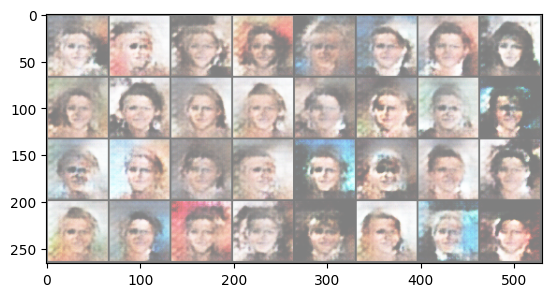

Epoch [0/5] Batch 1100/1583                   Loss D: 0.4395, loss G: 1.6350


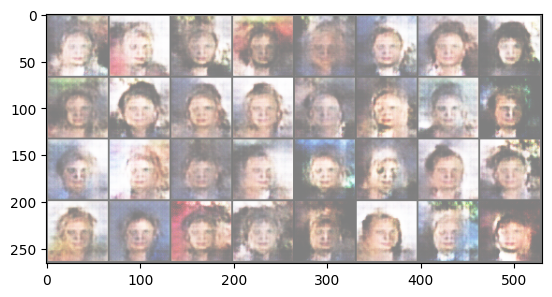

Epoch [0/5] Batch 1150/1583                   Loss D: 0.3893, loss G: 2.0815


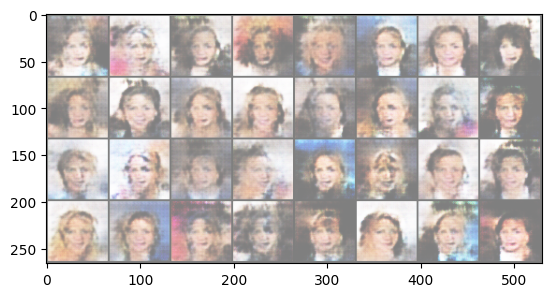

Epoch [0/5] Batch 1200/1583                   Loss D: 0.4259, loss G: 1.8104


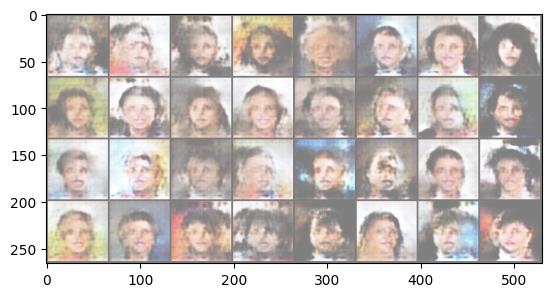

Epoch [0/5] Batch 1250/1583                   Loss D: 0.4319, loss G: 1.7558


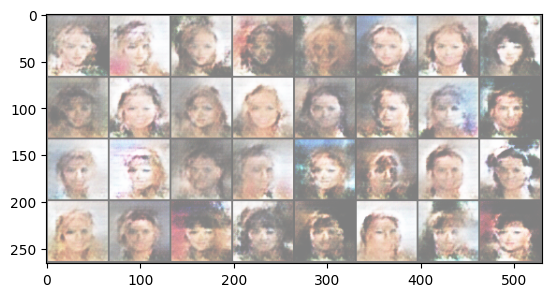

Epoch [0/5] Batch 1300/1583                   Loss D: 0.7401, loss G: 1.8106


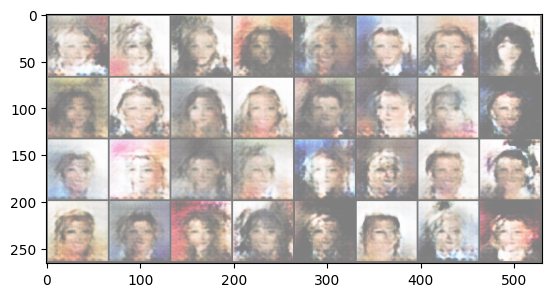

Epoch [0/5] Batch 1350/1583                   Loss D: 0.4064, loss G: 1.7778


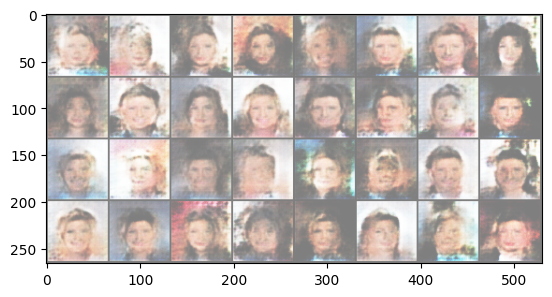

Epoch [0/5] Batch 1400/1583                   Loss D: 0.4461, loss G: 1.3868


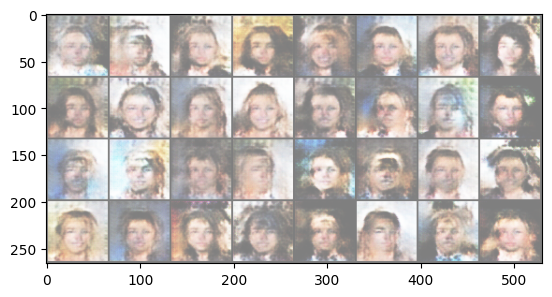

Epoch [0/5] Batch 1450/1583                   Loss D: 0.6037, loss G: 4.3733


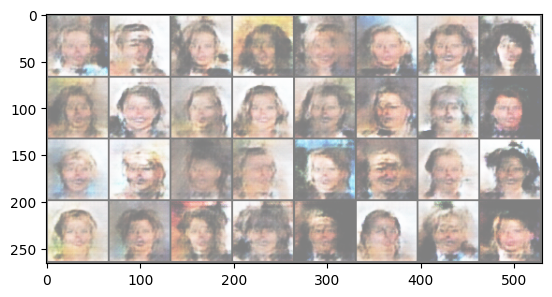

Epoch [0/5] Batch 1500/1583                   Loss D: 0.7459, loss G: 4.7245


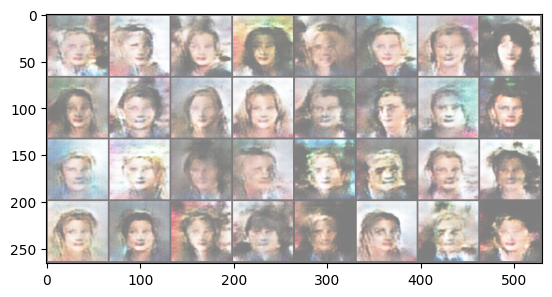

Epoch [0/5] Batch 1550/1583                   Loss D: 0.3340, loss G: 1.7608


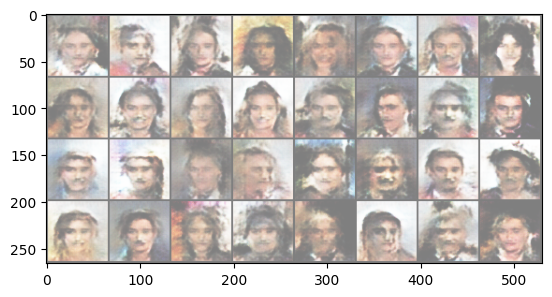

Epoch [1/5] Batch 0/1583                   Loss D: 0.1502, loss G: 2.9629


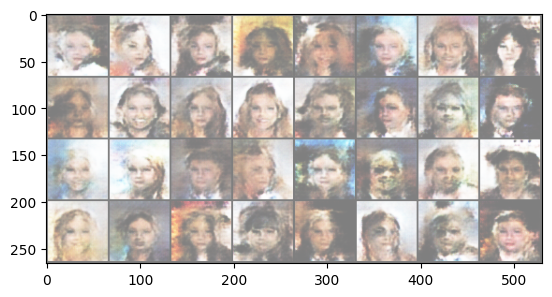

Epoch [1/5] Batch 50/1583                   Loss D: 0.3459, loss G: 2.2326


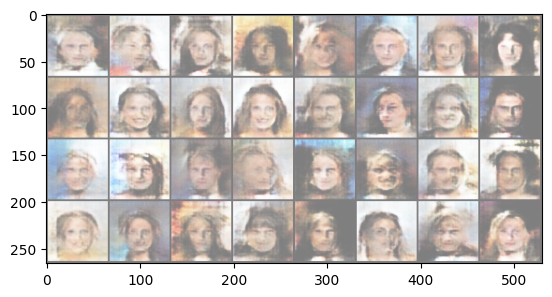

Epoch [1/5] Batch 100/1583                   Loss D: 0.7909, loss G: 1.4368


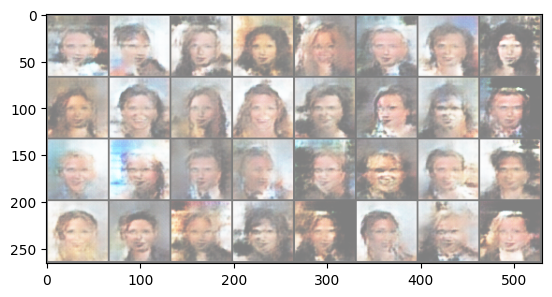

Epoch [1/5] Batch 150/1583                   Loss D: 0.4094, loss G: 2.1179


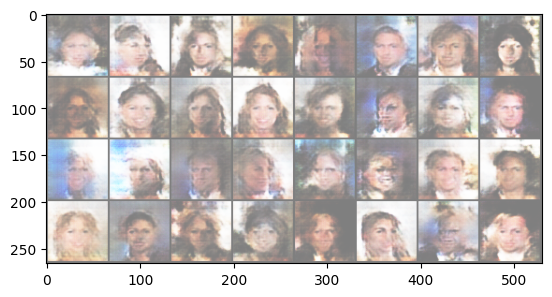

Epoch [1/5] Batch 200/1583                   Loss D: 0.2225, loss G: 2.2626


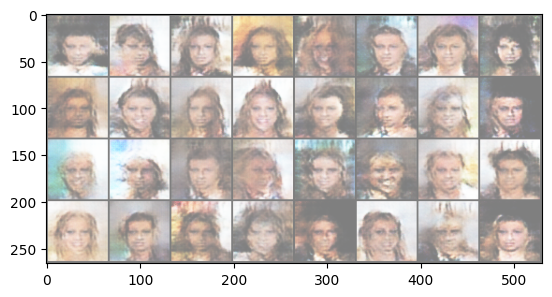

Epoch [1/5] Batch 250/1583                   Loss D: 0.3800, loss G: 1.9175


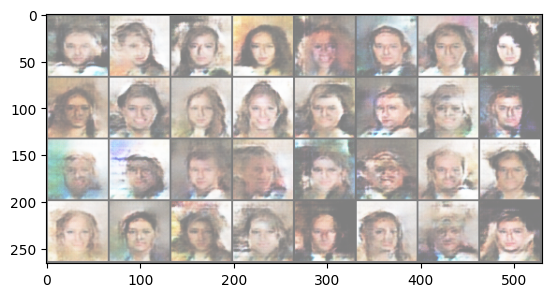

Epoch [1/5] Batch 300/1583                   Loss D: 0.4865, loss G: 5.0728


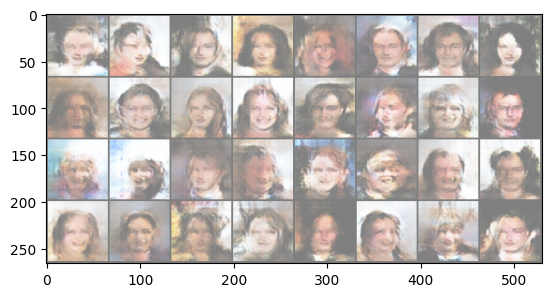

Epoch [1/5] Batch 350/1583                   Loss D: 0.3227, loss G: 2.9908


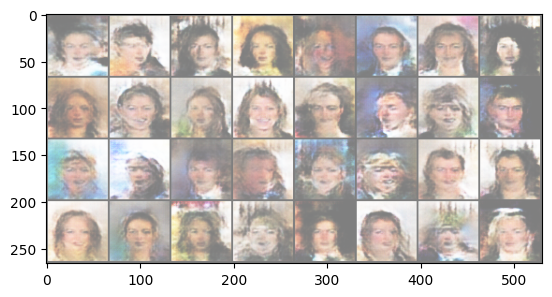

Epoch [1/5] Batch 400/1583                   Loss D: 0.3646, loss G: 3.2170


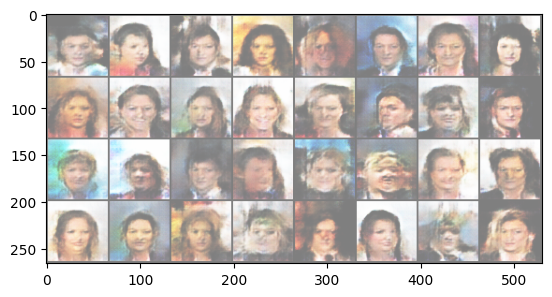

Epoch [1/5] Batch 450/1583                   Loss D: 0.1827, loss G: 2.1241


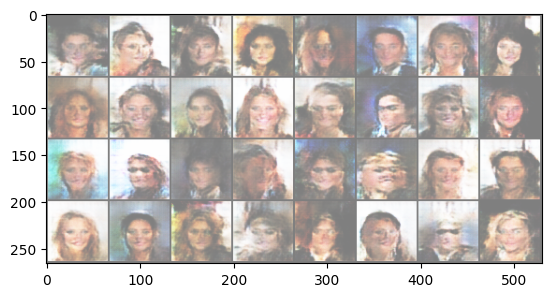

Epoch [1/5] Batch 500/1583                   Loss D: 0.1842, loss G: 2.2070


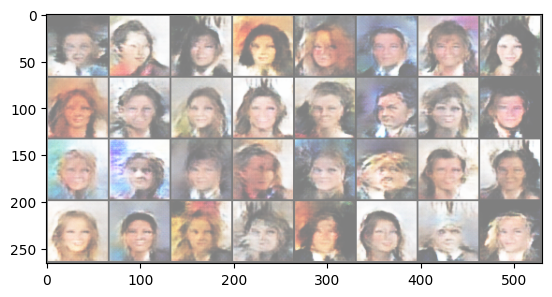

Epoch [1/5] Batch 550/1583                   Loss D: 0.5266, loss G: 2.3546


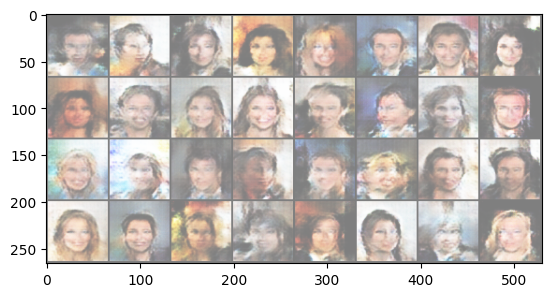

Epoch [1/5] Batch 600/1583                   Loss D: 0.1743, loss G: 3.4724


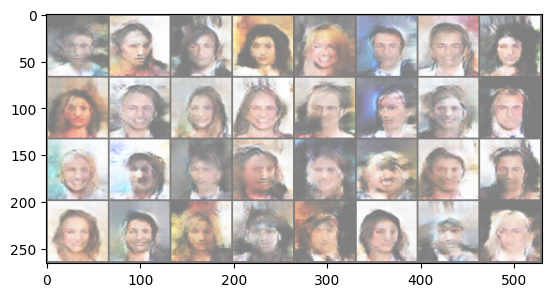

Epoch [1/5] Batch 650/1583                   Loss D: 0.4110, loss G: 5.7686


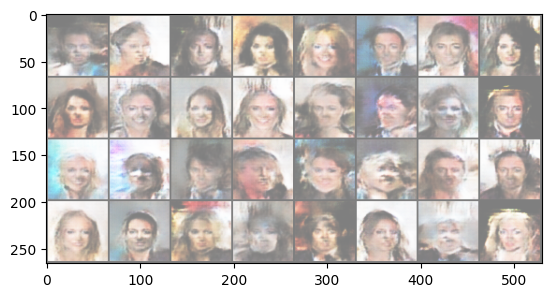

Epoch [1/5] Batch 700/1583                   Loss D: 0.2980, loss G: 3.4794


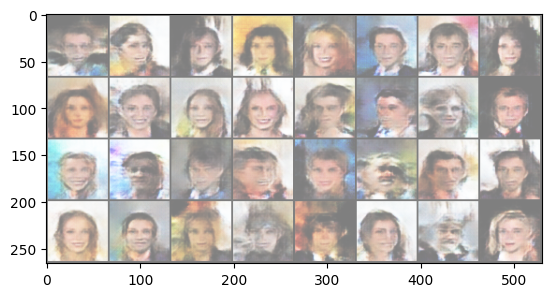

Epoch [1/5] Batch 750/1583                   Loss D: 0.1434, loss G: 2.8809


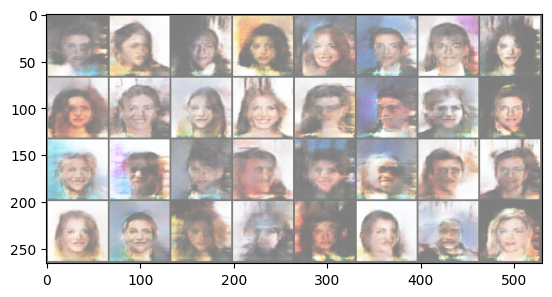

Epoch [1/5] Batch 800/1583                   Loss D: 0.0953, loss G: 2.8377


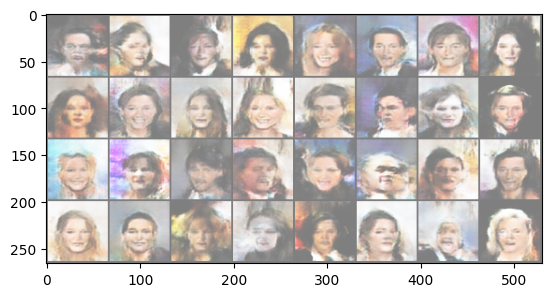

Epoch [1/5] Batch 850/1583                   Loss D: 0.6027, loss G: 0.7046


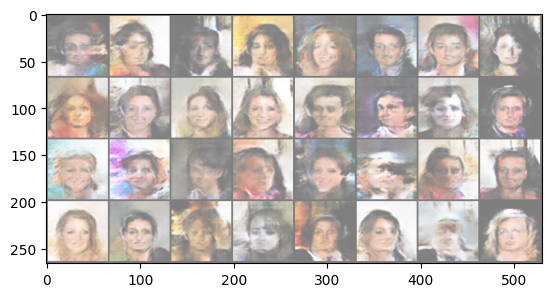

Epoch [1/5] Batch 900/1583                   Loss D: 0.2639, loss G: 3.0488


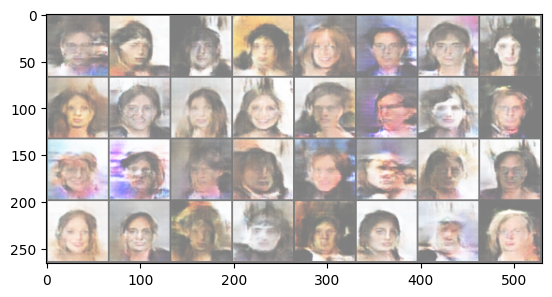

Epoch [1/5] Batch 950/1583                   Loss D: 0.0837, loss G: 3.1268


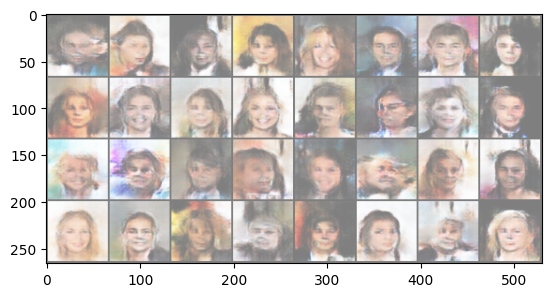

Epoch [1/5] Batch 1000/1583                   Loss D: 0.3321, loss G: 3.3586


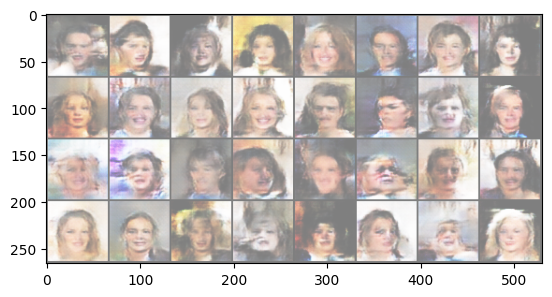

Epoch [1/5] Batch 1050/1583                   Loss D: 0.3448, loss G: 2.5790


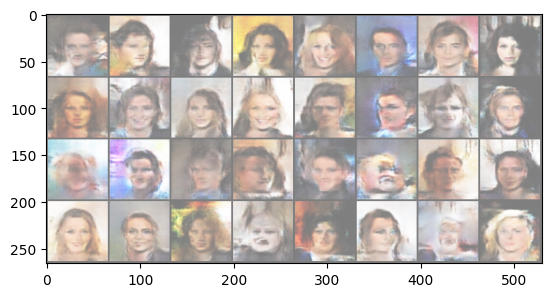

Epoch [1/5] Batch 1100/1583                   Loss D: 0.5048, loss G: 3.8507


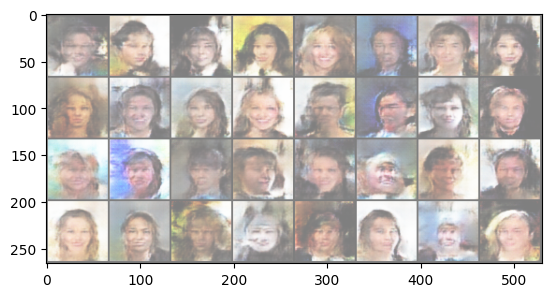

Epoch [1/5] Batch 1150/1583                   Loss D: 0.2522, loss G: 3.0007


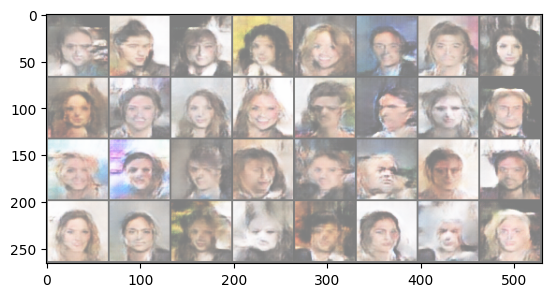

Epoch [1/5] Batch 1200/1583                   Loss D: 0.3317, loss G: 2.4488


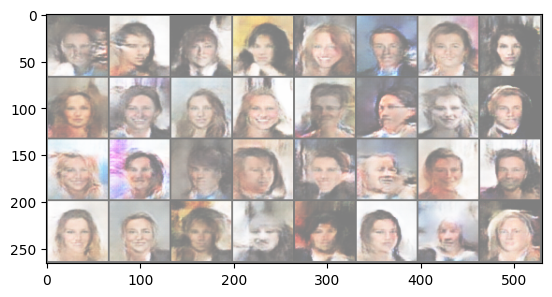

Epoch [1/5] Batch 1250/1583                   Loss D: 0.4930, loss G: 5.9961


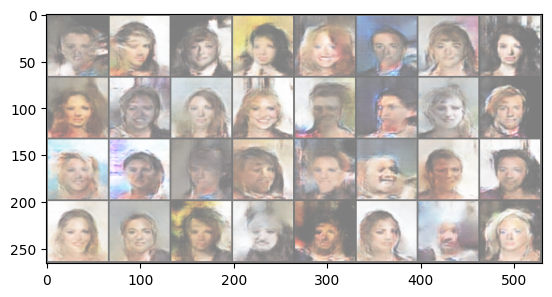

Epoch [1/5] Batch 1300/1583                   Loss D: 0.2435, loss G: 3.7755


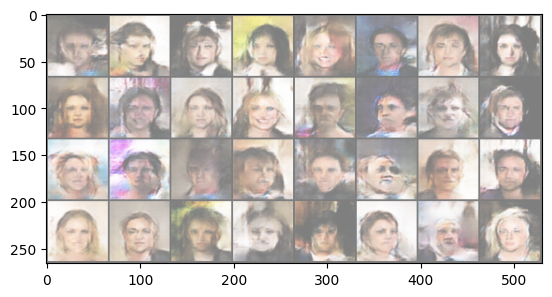

Epoch [1/5] Batch 1350/1583                   Loss D: 0.5942, loss G: 7.7260


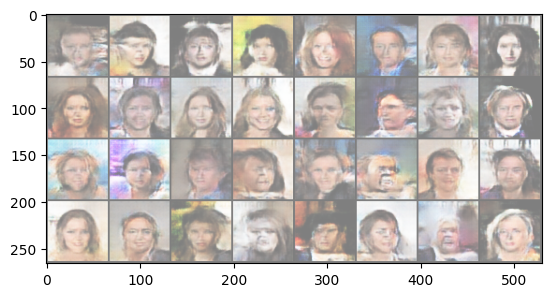

Epoch [1/5] Batch 1400/1583                   Loss D: 0.6867, loss G: 6.4111


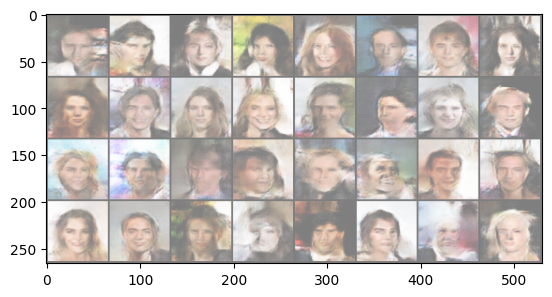

Epoch [1/5] Batch 1450/1583                   Loss D: 0.2586, loss G: 4.5806


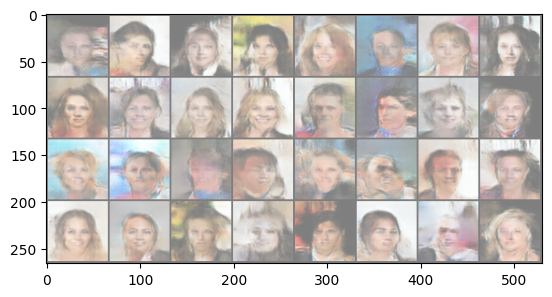

Epoch [1/5] Batch 1500/1583                   Loss D: 0.5175, loss G: 6.0236


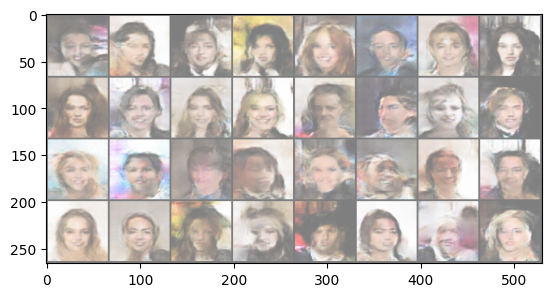

Epoch [1/5] Batch 1550/1583                   Loss D: 0.1516, loss G: 3.5927


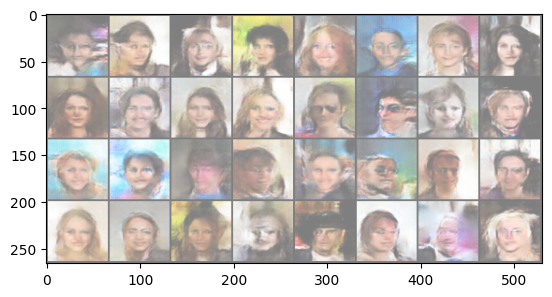

Epoch [2/5] Batch 0/1583                   Loss D: 0.1412, loss G: 2.7977


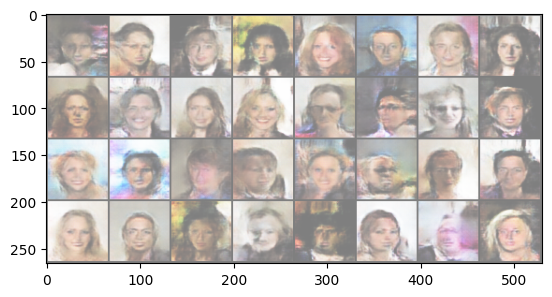

Epoch [2/5] Batch 50/1583                   Loss D: 0.2529, loss G: 5.8823


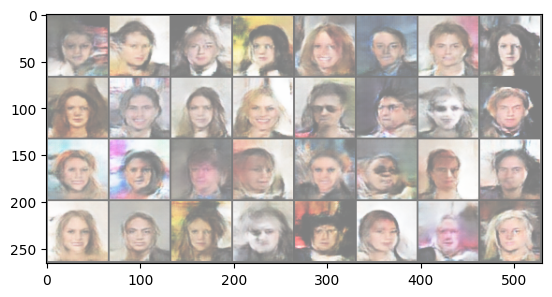

Epoch [2/5] Batch 100/1583                   Loss D: 0.2327, loss G: 3.4347


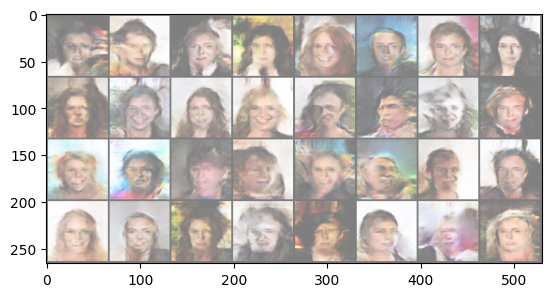

Epoch [2/5] Batch 150/1583                   Loss D: 0.0927, loss G: 2.3793


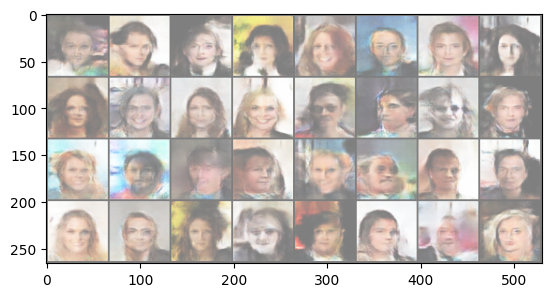

Epoch [2/5] Batch 200/1583                   Loss D: 0.6574, loss G: 5.9888


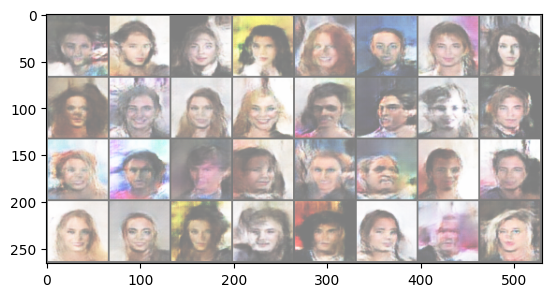

Epoch [2/5] Batch 250/1583                   Loss D: 0.8545, loss G: 1.9367


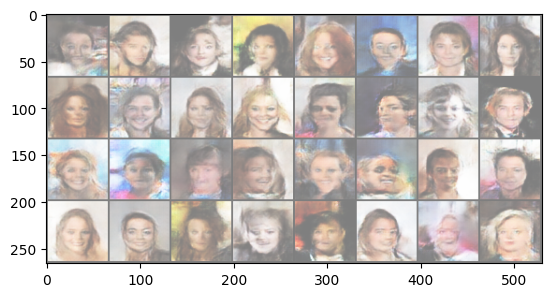

Epoch [2/5] Batch 300/1583                   Loss D: 0.1205, loss G: 3.2582


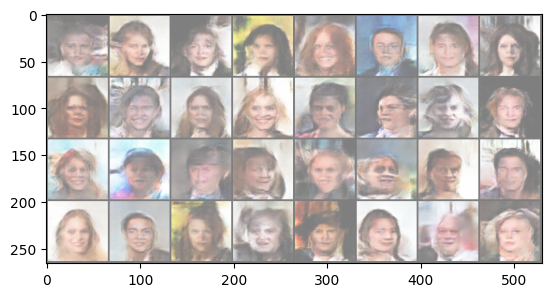

Epoch [2/5] Batch 350/1583                   Loss D: 0.3323, loss G: 2.3518


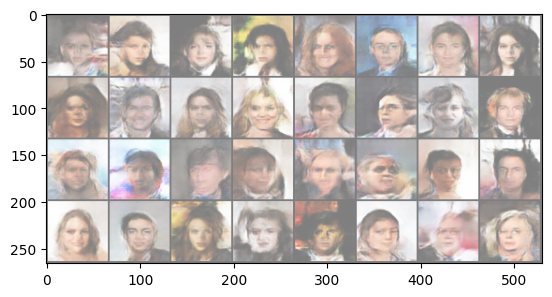

Epoch [2/5] Batch 400/1583                   Loss D: 0.2734, loss G: 1.5086


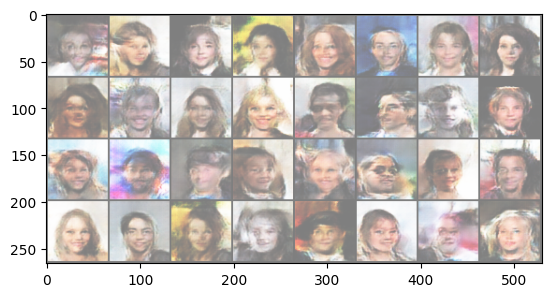

Epoch [2/5] Batch 450/1583                   Loss D: 0.2863, loss G: 3.3735


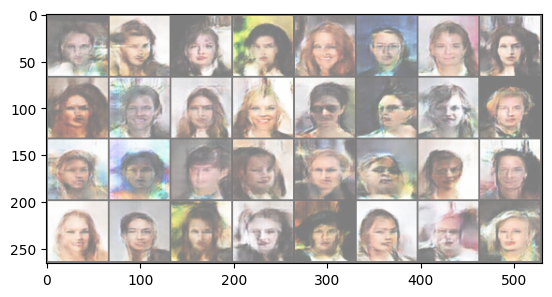

Epoch [2/5] Batch 500/1583                   Loss D: 0.1281, loss G: 3.0945


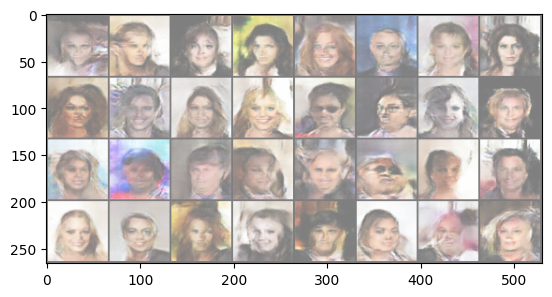

Epoch [2/5] Batch 550/1583                   Loss D: 0.1371, loss G: 3.0081


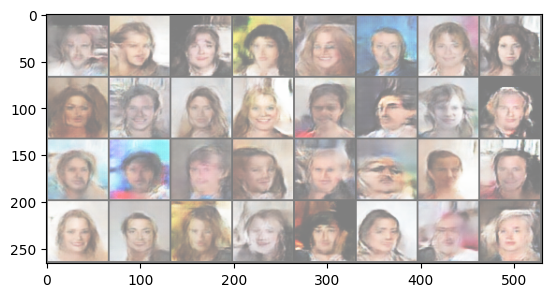

Epoch [2/5] Batch 600/1583                   Loss D: 0.4039, loss G: 5.5785


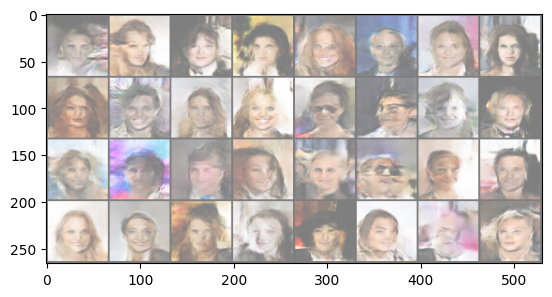

Epoch [2/5] Batch 650/1583                   Loss D: 0.1927, loss G: 4.0831


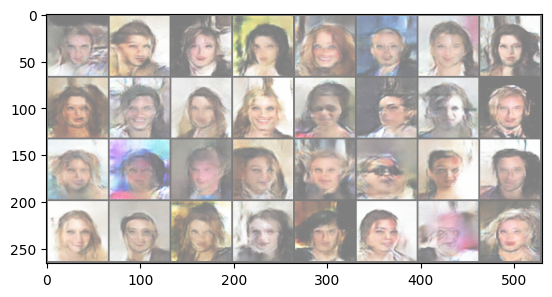

Epoch [2/5] Batch 700/1583                   Loss D: 0.3590, loss G: 4.9491


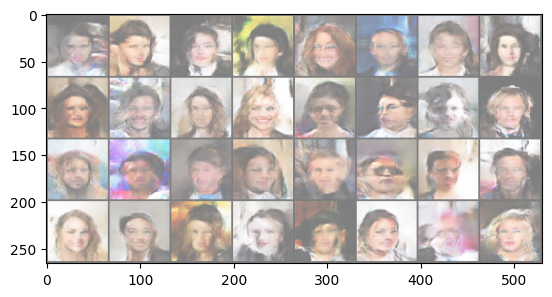

Epoch [2/5] Batch 750/1583                   Loss D: 0.3602, loss G: 4.2696


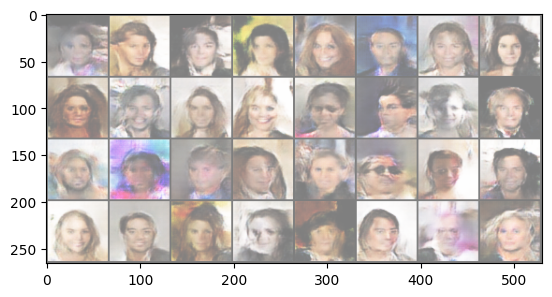

Epoch [2/5] Batch 800/1583                   Loss D: 0.1789, loss G: 2.5783


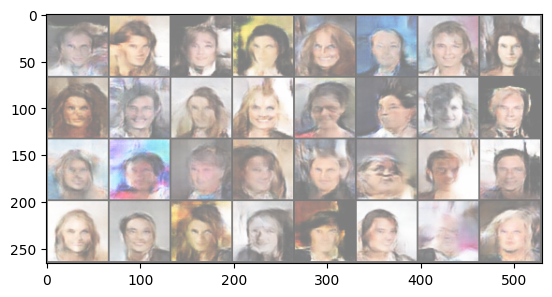

Epoch [2/5] Batch 850/1583                   Loss D: 0.2520, loss G: 2.8497


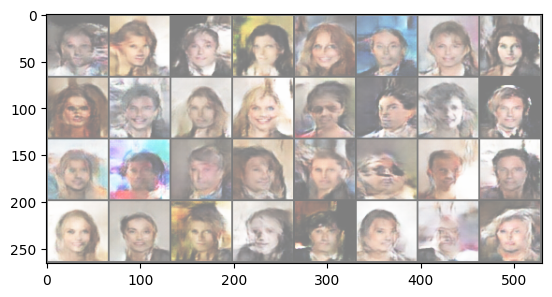

Epoch [2/5] Batch 900/1583                   Loss D: 1.6599, loss G: 1.6044


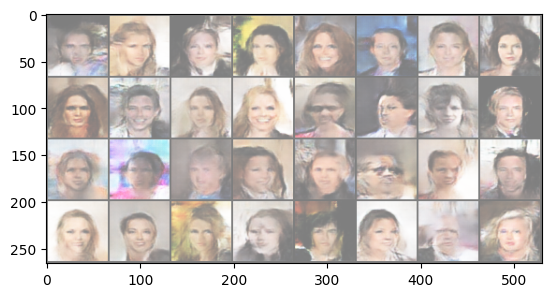

Epoch [2/5] Batch 950/1583                   Loss D: 0.1469, loss G: 3.2809


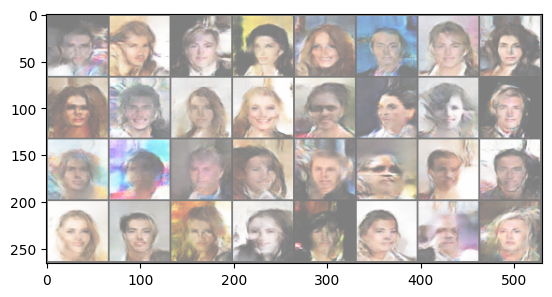

Epoch [2/5] Batch 1000/1583                   Loss D: 0.0756, loss G: 2.7083


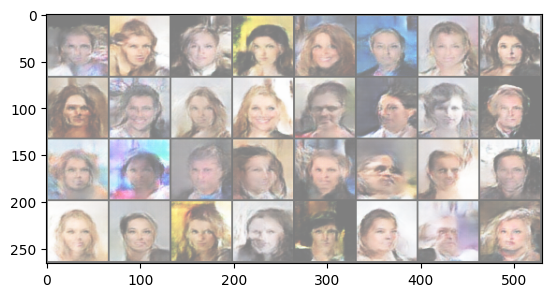

Epoch [2/5] Batch 1050/1583                   Loss D: 0.2047, loss G: 2.4411


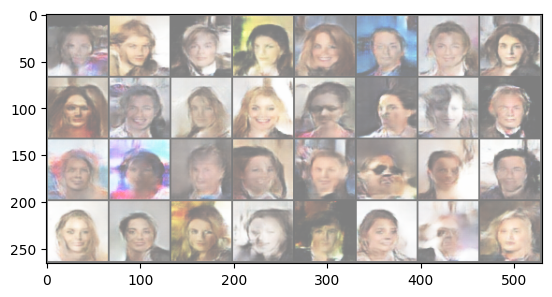

Epoch [2/5] Batch 1100/1583                   Loss D: 0.2283, loss G: 2.0764


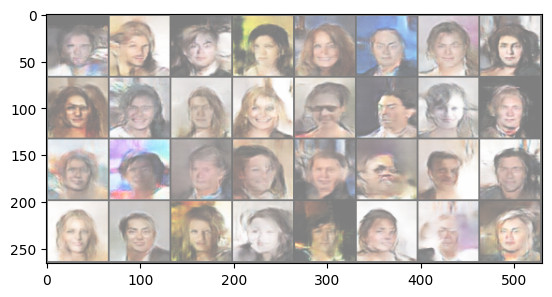

Epoch [2/5] Batch 1150/1583                   Loss D: 0.2724, loss G: 3.4948


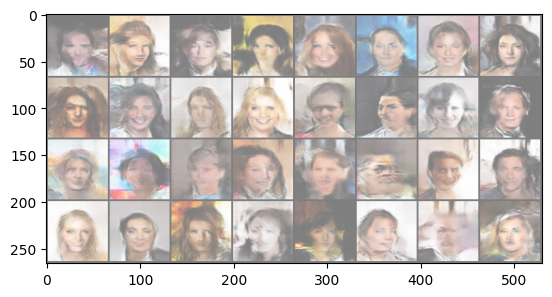

Epoch [2/5] Batch 1200/1583                   Loss D: 0.2683, loss G: 5.1789


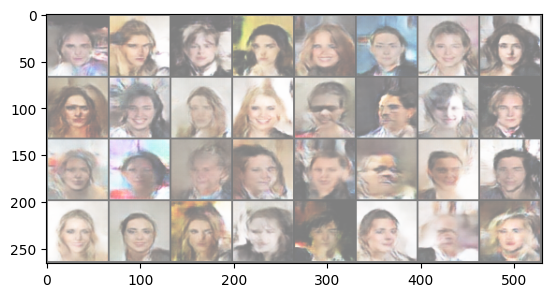

Epoch [2/5] Batch 1250/1583                   Loss D: 0.1433, loss G: 2.5620


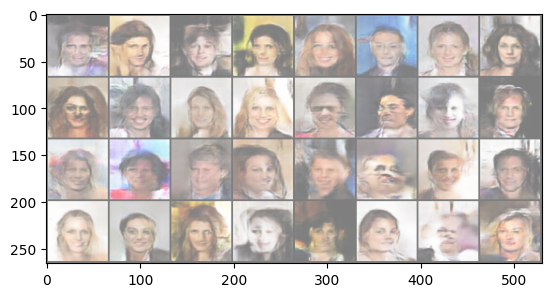

Epoch [2/5] Batch 1300/1583                   Loss D: 0.2630, loss G: 4.4979


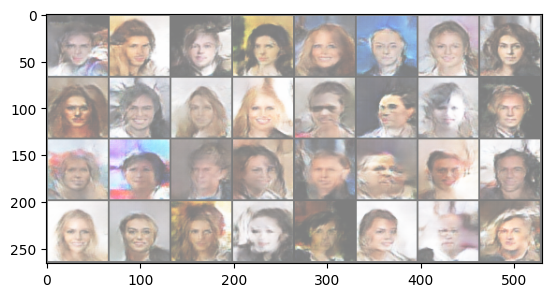

Epoch [2/5] Batch 1350/1583                   Loss D: 0.3171, loss G: 2.1333


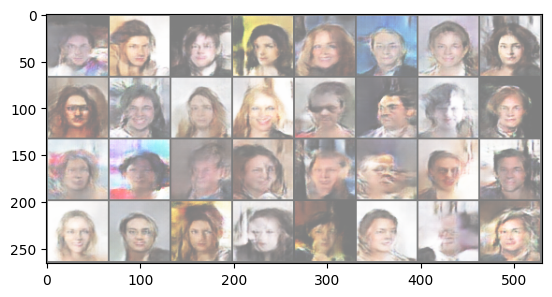

Epoch [2/5] Batch 1400/1583                   Loss D: 0.1684, loss G: 3.0682


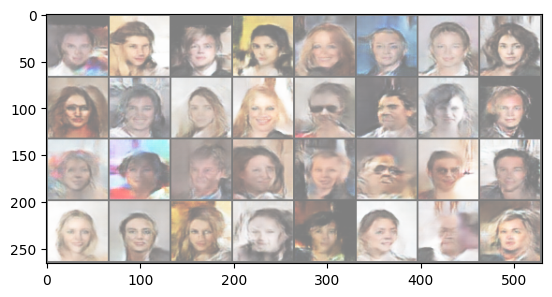

Epoch [2/5] Batch 1450/1583                   Loss D: 0.2257, loss G: 4.6569


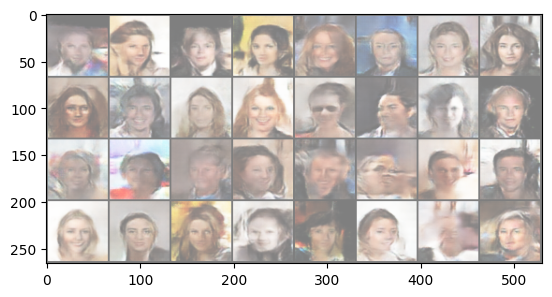

Epoch [2/5] Batch 1500/1583                   Loss D: 0.1694, loss G: 4.4677


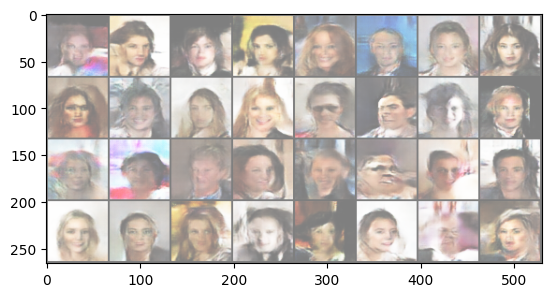

Epoch [2/5] Batch 1550/1583                   Loss D: 0.2782, loss G: 2.8690


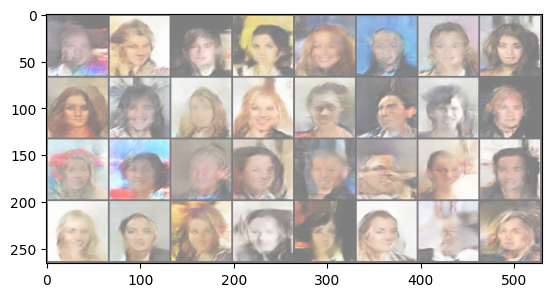

Epoch [3/5] Batch 0/1583                   Loss D: 1.4359, loss G: 0.2631


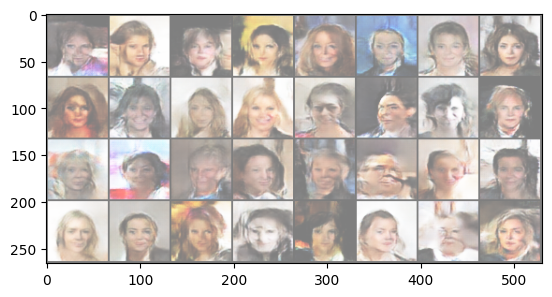

Epoch [3/5] Batch 50/1583                   Loss D: 0.2422, loss G: 2.8878


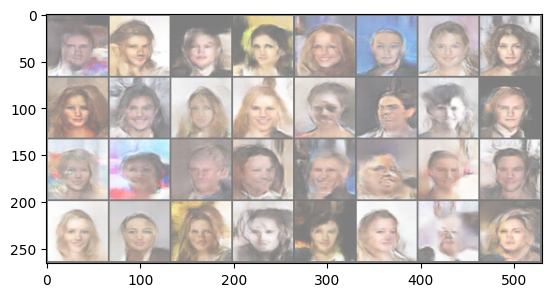

Epoch [3/5] Batch 100/1583                   Loss D: 0.2681, loss G: 5.4698


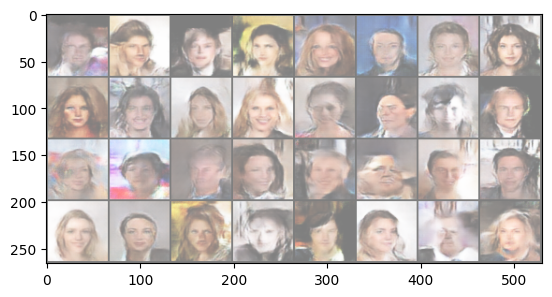

Epoch [3/5] Batch 150/1583                   Loss D: 0.2254, loss G: 2.4112


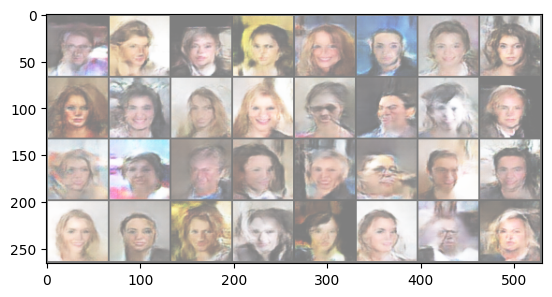

Epoch [3/5] Batch 200/1583                   Loss D: 0.5001, loss G: 5.0423


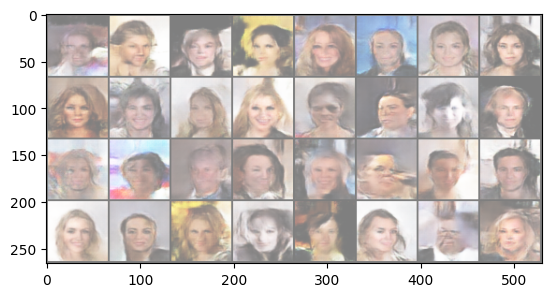

Epoch [3/5] Batch 250/1583                   Loss D: 0.2522, loss G: 1.7328


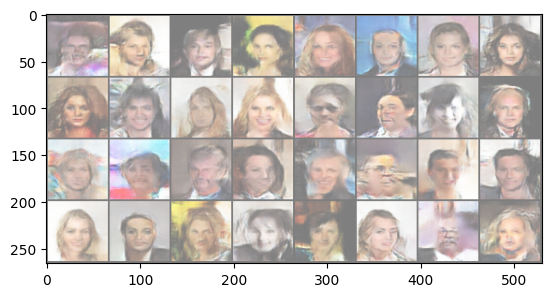

Epoch [3/5] Batch 300/1583                   Loss D: 0.2225, loss G: 3.6425


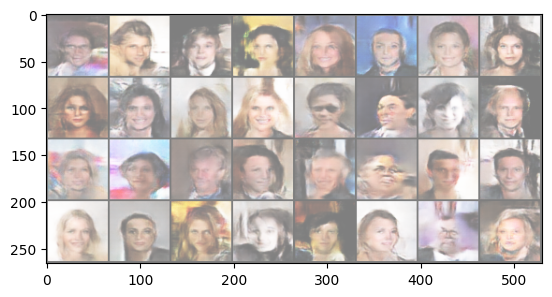

Epoch [3/5] Batch 350/1583                   Loss D: 0.2595, loss G: 7.2004


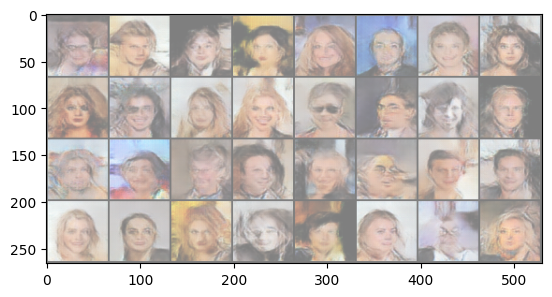

Epoch [3/5] Batch 400/1583                   Loss D: 0.1121, loss G: 4.3118


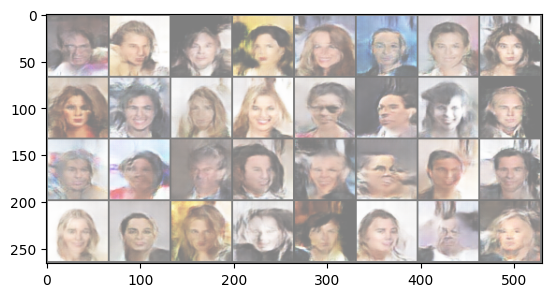

Epoch [3/5] Batch 450/1583                   Loss D: 0.1354, loss G: 3.2962


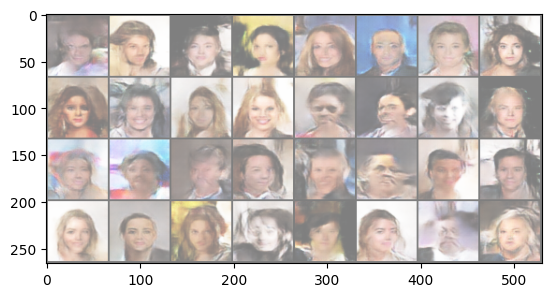

Epoch [3/5] Batch 500/1583                   Loss D: 0.0642, loss G: 2.9261


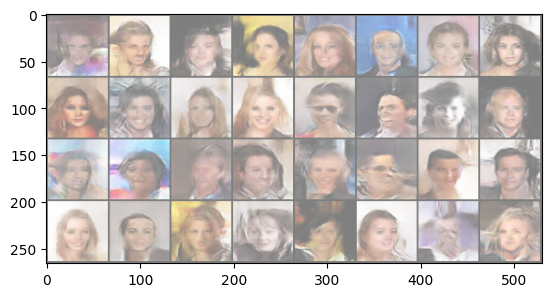

Epoch [3/5] Batch 550/1583                   Loss D: 0.1277, loss G: 3.5713


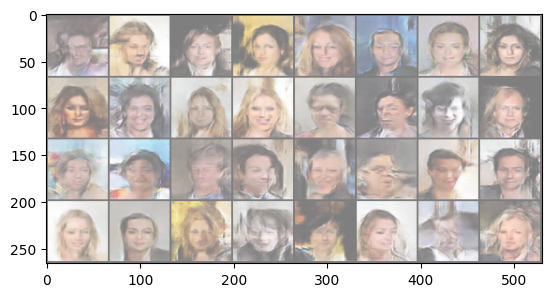

Epoch [3/5] Batch 600/1583                   Loss D: 0.1150, loss G: 3.4419


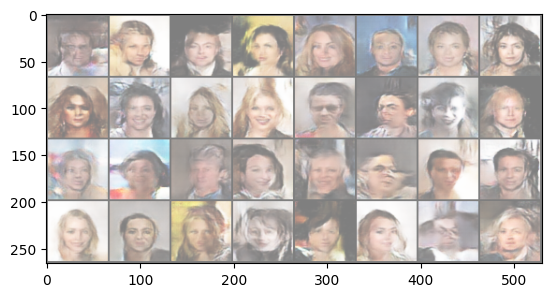

Epoch [3/5] Batch 650/1583                   Loss D: 0.1162, loss G: 3.1719


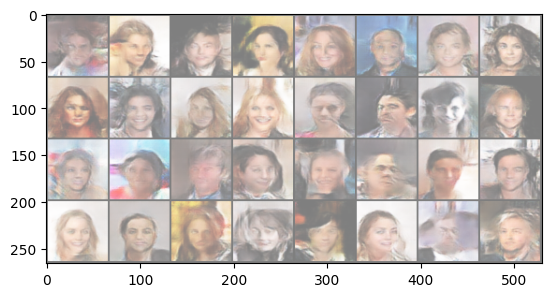

Epoch [3/5] Batch 700/1583                   Loss D: 0.1622, loss G: 2.1733


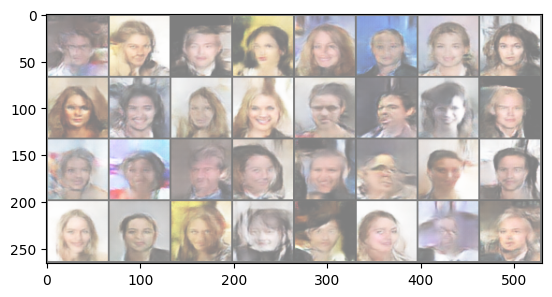

Epoch [3/5] Batch 750/1583                   Loss D: 0.9974, loss G: 0.3925


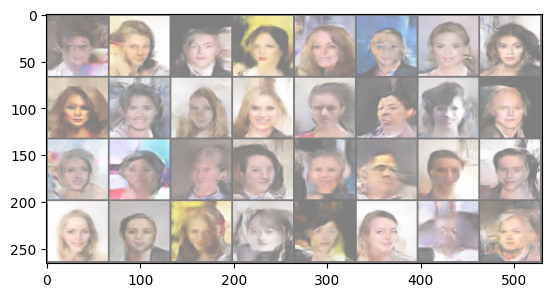

Epoch [3/5] Batch 800/1583                   Loss D: 0.1656, loss G: 1.8716


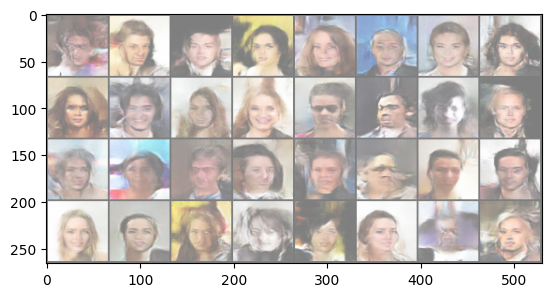

Epoch [3/5] Batch 850/1583                   Loss D: 0.1863, loss G: 4.3570


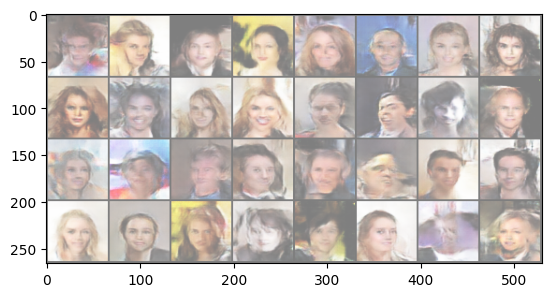

Epoch [3/5] Batch 900/1583                   Loss D: 0.6682, loss G: 6.5564


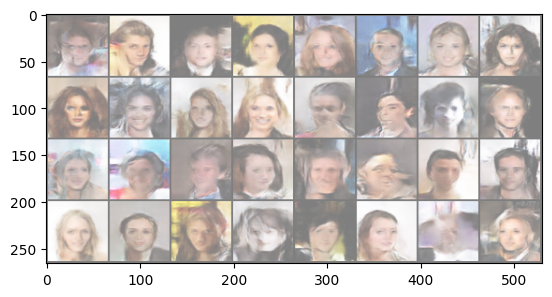

Epoch [3/5] Batch 950/1583                   Loss D: 0.2303, loss G: 2.1249


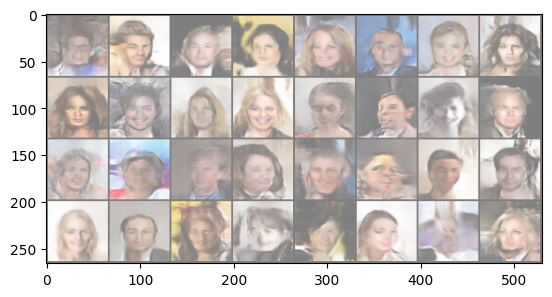

Epoch [3/5] Batch 1000/1583                   Loss D: 0.2413, loss G: 1.8806


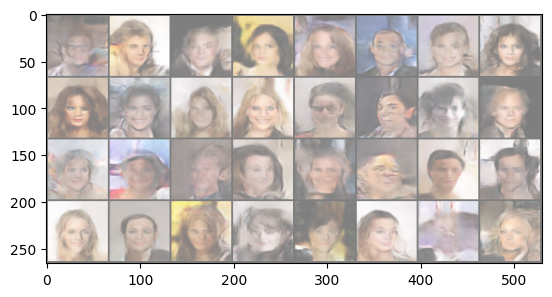

Epoch [3/5] Batch 1050/1583                   Loss D: 0.1184, loss G: 2.7412


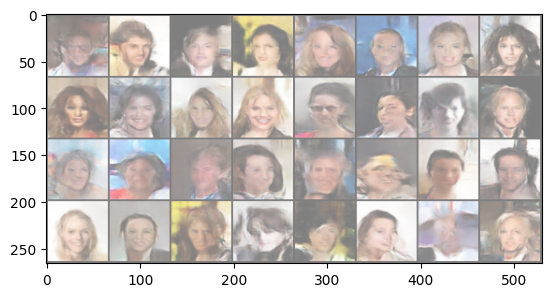

Epoch [3/5] Batch 1100/1583                   Loss D: 0.4490, loss G: 6.6266


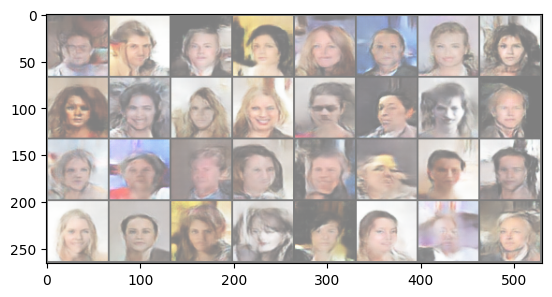

Epoch [3/5] Batch 1150/1583                   Loss D: 0.1897, loss G: 3.2916


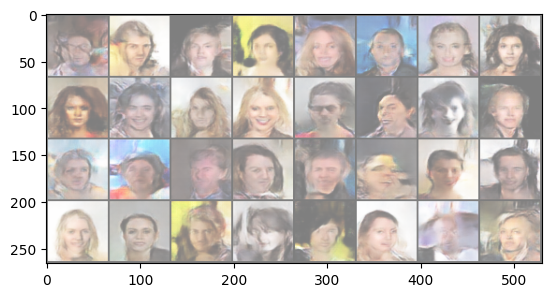

Epoch [3/5] Batch 1200/1583                   Loss D: 0.1919, loss G: 3.0183


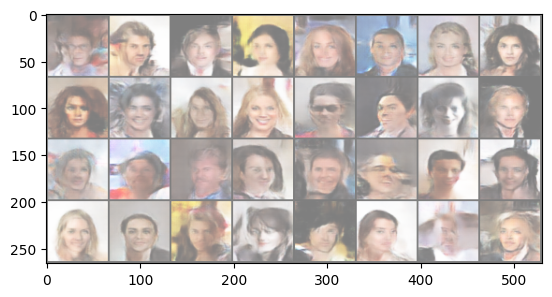

Epoch [3/5] Batch 1250/1583                   Loss D: 0.2185, loss G: 5.1737


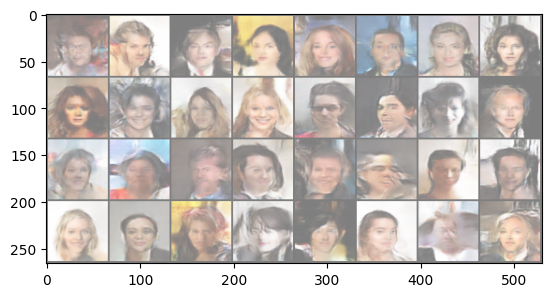

Epoch [3/5] Batch 1300/1583                   Loss D: 1.5044, loss G: 0.1445


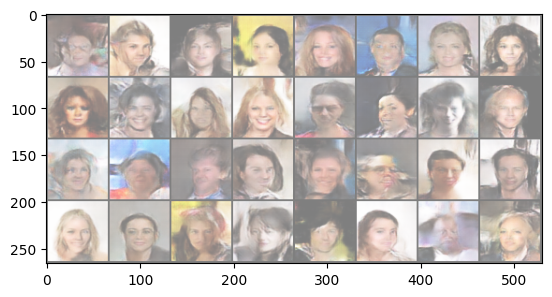

Epoch [3/5] Batch 1350/1583                   Loss D: 0.1732, loss G: 3.3424


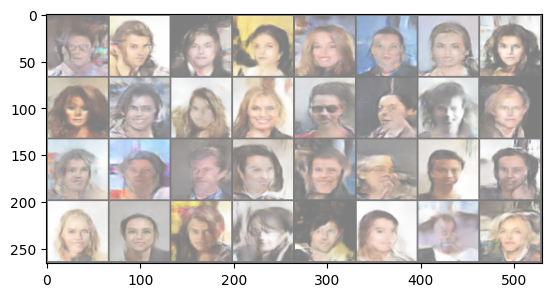

Epoch [3/5] Batch 1400/1583                   Loss D: 0.7894, loss G: 1.1060


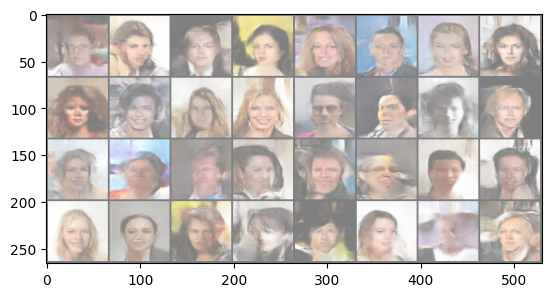

Epoch [3/5] Batch 1450/1583                   Loss D: 0.1372, loss G: 4.3985


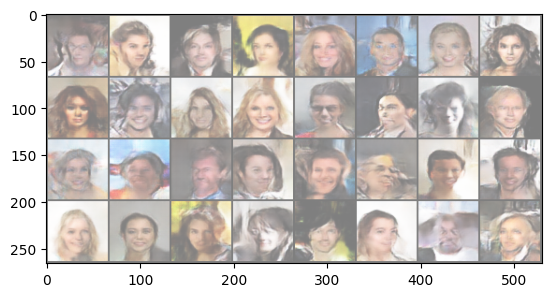

Epoch [3/5] Batch 1500/1583                   Loss D: 0.3147, loss G: 6.7566


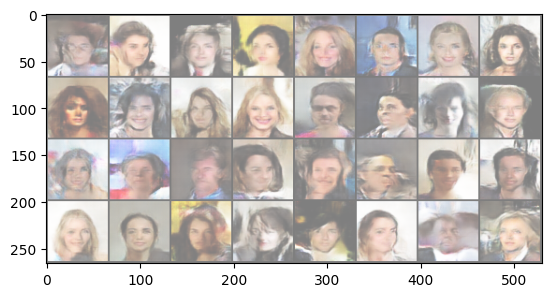

Epoch [3/5] Batch 1550/1583                   Loss D: 0.2058, loss G: 5.8856


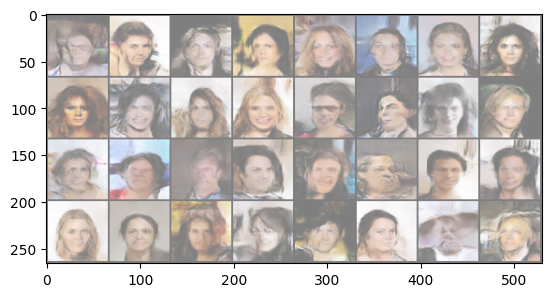

Epoch [4/5] Batch 0/1583                   Loss D: 0.2230, loss G: 1.5209


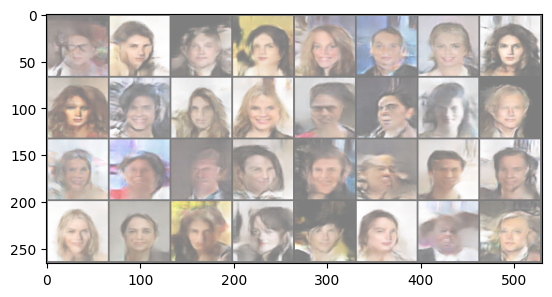

Epoch [4/5] Batch 50/1583                   Loss D: 1.0821, loss G: 2.3106


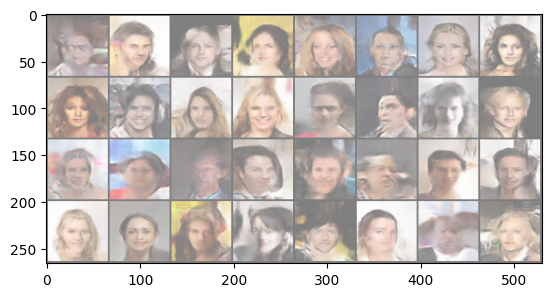

Epoch [4/5] Batch 100/1583                   Loss D: 0.2698, loss G: 5.2296


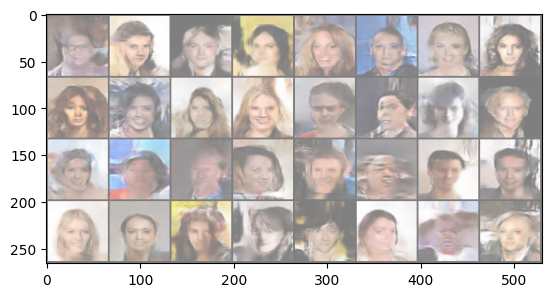

Epoch [4/5] Batch 150/1583                   Loss D: 0.1388, loss G: 3.7074


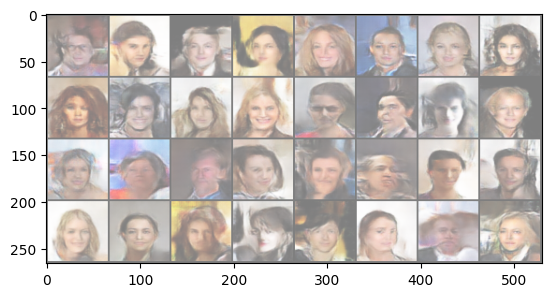

Epoch [4/5] Batch 200/1583                   Loss D: 0.1990, loss G: 3.1964


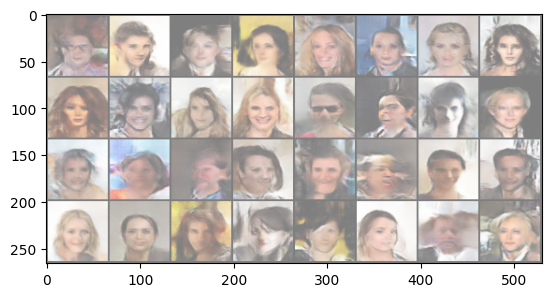

Epoch [4/5] Batch 250/1583                   Loss D: 0.1152, loss G: 3.8236


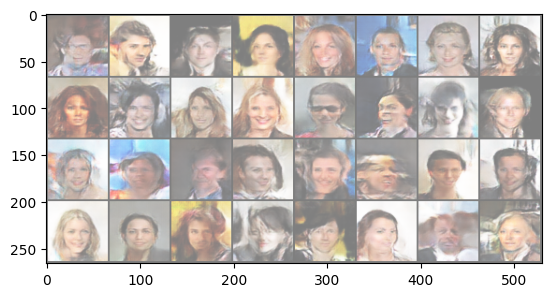

Epoch [4/5] Batch 300/1583                   Loss D: 0.2767, loss G: 4.7060


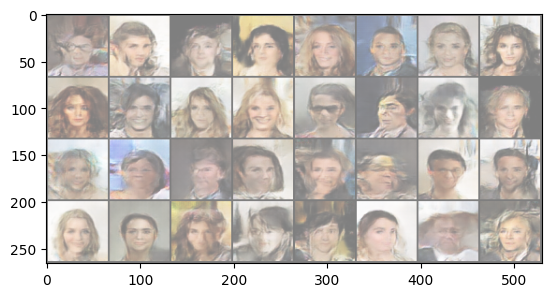

Epoch [4/5] Batch 350/1583                   Loss D: 0.1938, loss G: 4.3212


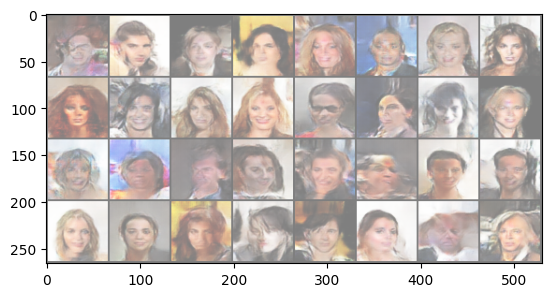

Epoch [4/5] Batch 400/1583                   Loss D: 0.1116, loss G: 3.3677


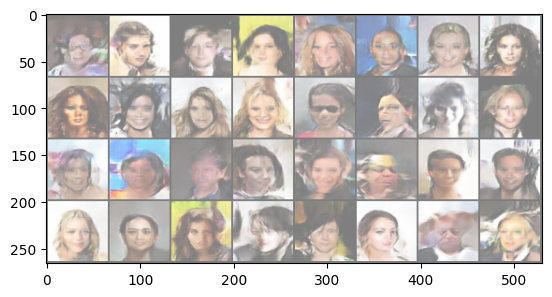

Epoch [4/5] Batch 450/1583                   Loss D: 0.1375, loss G: 3.5415


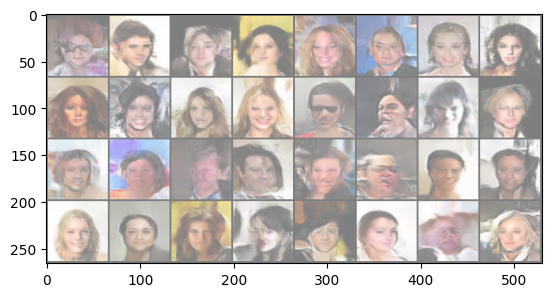

Epoch [4/5] Batch 500/1583                   Loss D: 0.3876, loss G: 1.4508


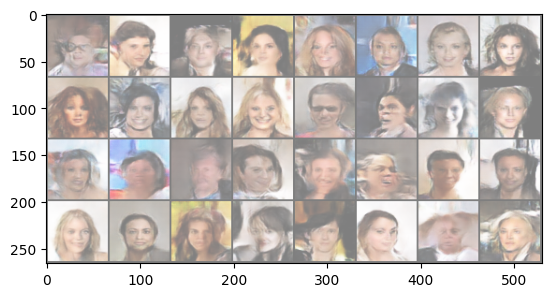

Epoch [4/5] Batch 550/1583                   Loss D: 0.3211, loss G: 4.7593


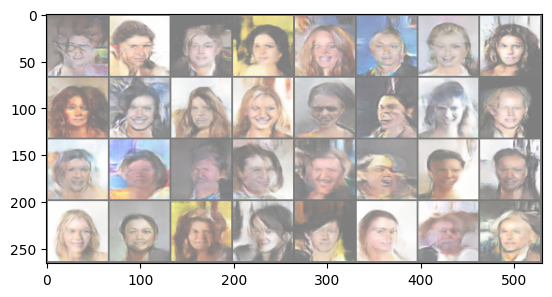

Epoch [4/5] Batch 600/1583                   Loss D: 0.1906, loss G: 4.0082


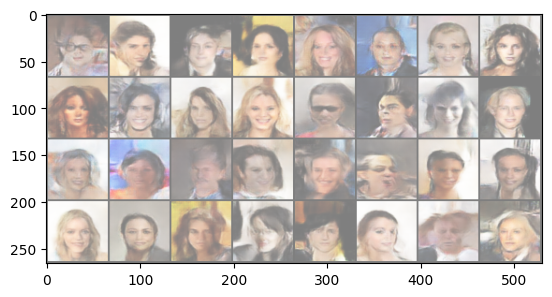

Epoch [4/5] Batch 650/1583                   Loss D: 0.2357, loss G: 5.9305


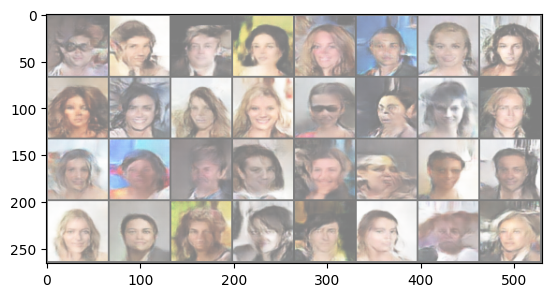

Epoch [4/5] Batch 700/1583                   Loss D: 0.1861, loss G: 3.8702


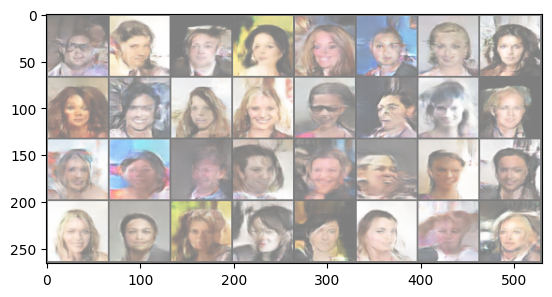

Epoch [4/5] Batch 750/1583                   Loss D: 0.1510, loss G: 4.2638


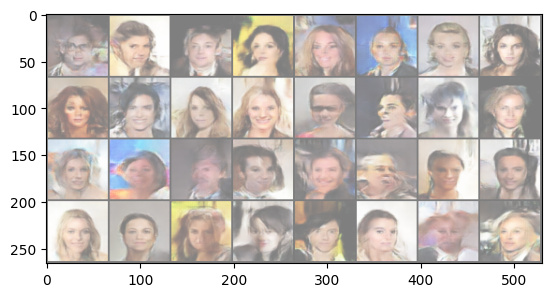

Epoch [4/5] Batch 800/1583                   Loss D: 0.4525, loss G: 2.2209


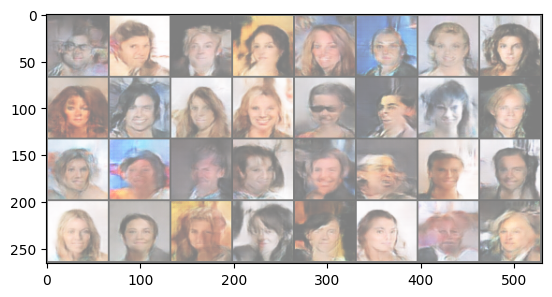

Epoch [4/5] Batch 850/1583                   Loss D: 0.4326, loss G: 1.4118


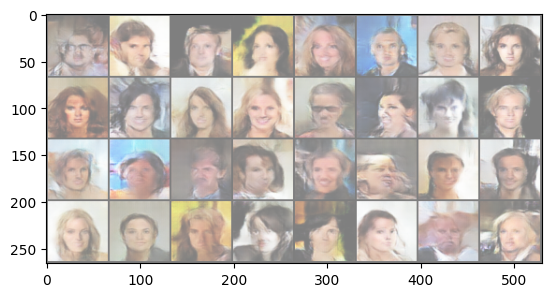

Epoch [4/5] Batch 900/1583                   Loss D: 0.1336, loss G: 2.6888


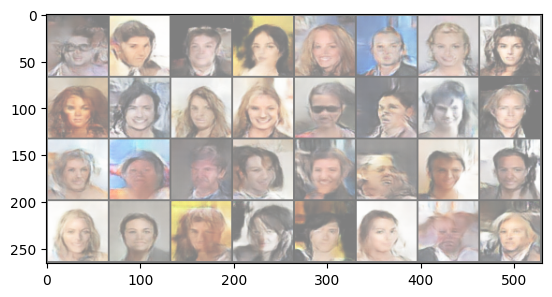

Epoch [4/5] Batch 950/1583                   Loss D: 0.2624, loss G: 0.8602


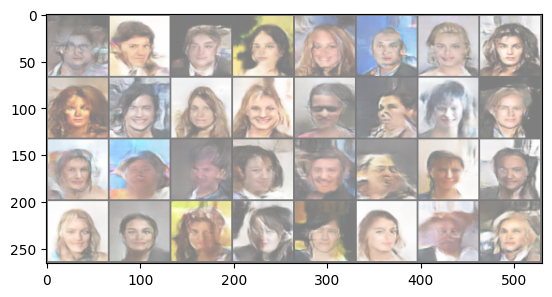

Epoch [4/5] Batch 1000/1583                   Loss D: 0.1310, loss G: 3.1626


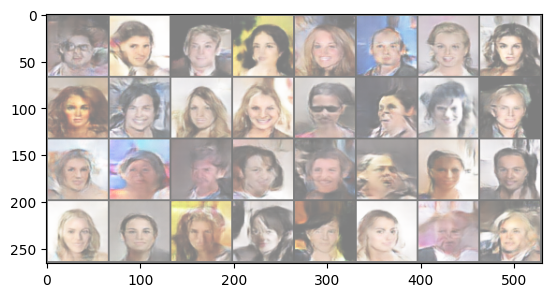

Epoch [4/5] Batch 1050/1583                   Loss D: 0.2452, loss G: 5.0708


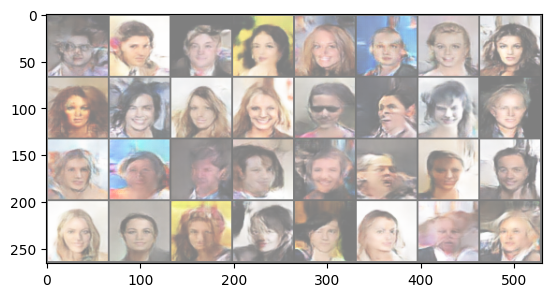

Epoch [4/5] Batch 1100/1583                   Loss D: 0.1836, loss G: 1.6327


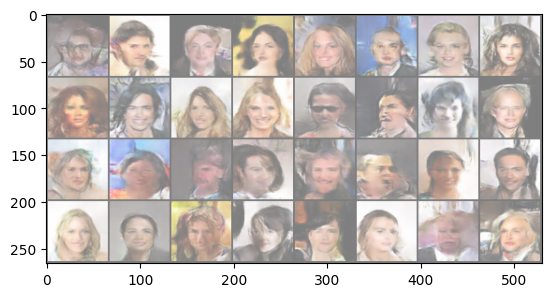

Epoch [4/5] Batch 1150/1583                   Loss D: 0.8116, loss G: 1.2261


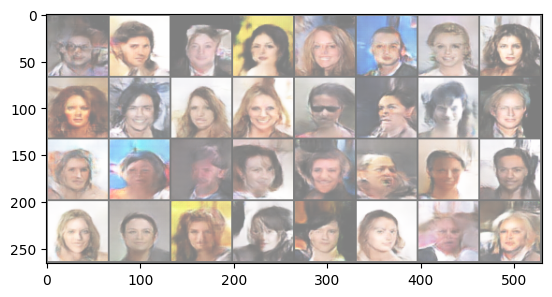

Epoch [4/5] Batch 1200/1583                   Loss D: 0.1595, loss G: 2.6149


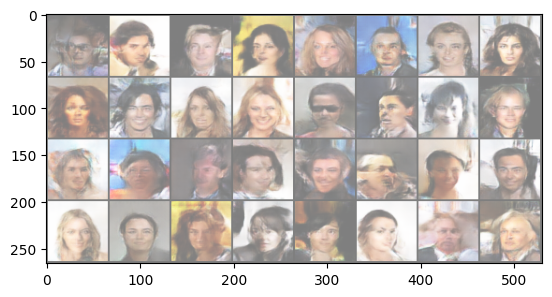

Epoch [4/5] Batch 1250/1583                   Loss D: 0.1394, loss G: 4.2120


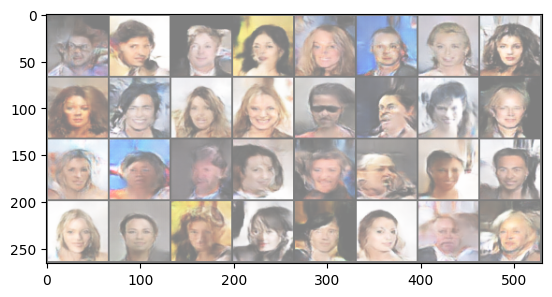

Epoch [4/5] Batch 1300/1583                   Loss D: 0.4991, loss G: 1.9079


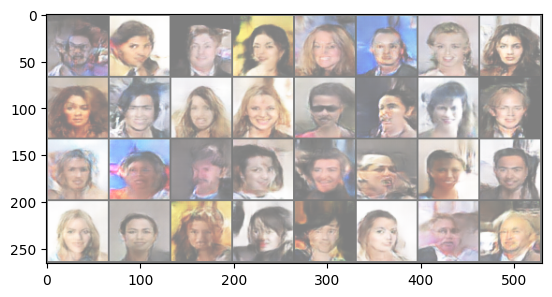

Epoch [4/5] Batch 1350/1583                   Loss D: 0.1801, loss G: 2.8911


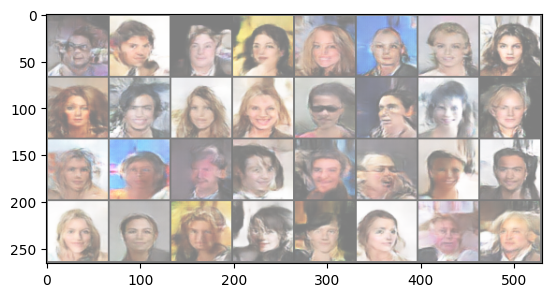

Epoch [4/5] Batch 1400/1583                   Loss D: 0.1528, loss G: 3.9526


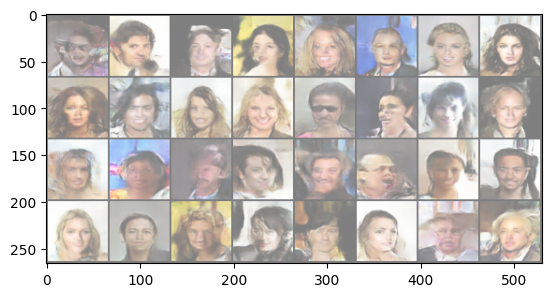

Epoch [4/5] Batch 1450/1583                   Loss D: 0.1849, loss G: 2.5187


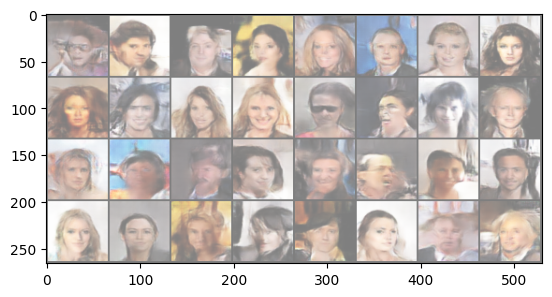

Epoch [4/5] Batch 1500/1583                   Loss D: 0.1203, loss G: 2.9598


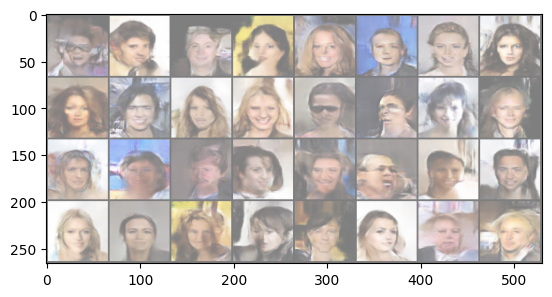

Epoch [4/5] Batch 1550/1583                   Loss D: 0.3742, loss G: 4.9365


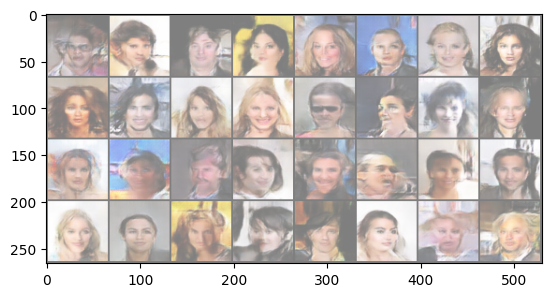

In [74]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)
        ### create noise tensor
        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        ### Print losses occasionally and fake images occasionally
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)

# reference 
https://medium.com/@manoharmanok/implementing-dcgan-in-pytorch-using-the-celeba-dataset-a-comprehensive-guide-660e6e8e29d2